# Predicting the case trajectories of Covid-19 using Machine Learning

The objective in this Notebook is to develop Machine Learning models to determine the case trajectories (mortality possibilities) of covid-19 patients based on their clinical parameters. The dataset used here is taken from the Government of Mexico Website: https://datos.gob.mx/busca/dataset/informacion-referente-a-casos-covid-19-en-mexico 


In [1]:
# Import the required libraries

#Regular Exploratory Data Analysis and plotting libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


# Models from sklearn
from sklearn.linear_model import LogisticRegression
import xgboost as xgb
from sklearn.ensemble import RandomForestClassifier

# Model Evaluations
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import confusion_matrix, classification_report, precision_score, recall_score
from sklearn.metrics import f1_score, RocCurveDisplay

# Other required tools
from sklearn.preprocessing import PolynomialFeatures, MinMaxScaler
from sklearn.pipeline import Pipeline

## LOAD DATA

In [2]:
# Import the dataset and save it as a pandas dataframe
covid_data = pd.read_csv("covid_symptoms_mexico.csv", low_memory=False)
pd.set_option("display.max_columns", None)
covid_data.head()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DATE_DIED,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU
0,No,1,Female,Returned Home,03/05/2020,NaN,Yes,65,No,No,No,No,No,Yes,No,No,No,No,No,3,NaN
1,No,1,Male,Returned Home,03/06/2020,NaN,Yes,72,NaN,No,No,No,No,Yes,No,No,Yes,Yes,No,5,NaN
2,No,1,Male,Hospitalised,09/06/2020,Yes,No,55,NaN,Yes,No,No,No,No,No,No,No,No,No,3,No
3,No,1,Female,Returned Home,12/06/2020,NaN,No,53,No,No,No,No,No,No,No,No,No,No,No,7,NaN
4,No,1,Male,Returned Home,21/06/2020,NaN,No,68,NaN,Yes,No,No,No,Yes,No,No,No,No,No,3,NaN


In [3]:
covid_data.shape

(1048575, 21)

In [4]:
# Import the data dictionary
covid_data_dictionary = pd.read_csv("covid_symptoms_mexico_data_dictionary.csv")
pd.set_option("display.max_colwidth", None)
covid_data_dictionary

,VARIABLE,TYPE,DESCRIPTION
0,USMER,STRING,"Indicates whether the patient was treated in medical units of the first, second or third level"
1,MEDICAL_UNIT,INTEGER,"The type of institution of the National Health System that provided the care, from 1 to 13"
2,SEX,STRING,Male or Female
3,PATIENT_TYPE,STRING,Has the patient returned home?
4,DATE_DIED,STRING,The date of the patients death
5,INTUBED,STRING,Is the patient connected to a ventilator?
6,PNEUMONIA,STRING,Does the patient have inflamed air sacs or not
7,AGE,INTEGER,Patient's age
8,PREGNANT,STRING,Is the patient pregnant?
9,DIABETES,STRING,Does the patient have diabetes?


## 1. Exploratory Data Analysis
This is a crucial component of the modelling process, where an exploration of the data using statistics and visualizations to guide the subsequent analysis and development of the models. An EDA permits a better understanding of the data available.`

In [5]:
# View information about the dataset
covid_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 21 columns):
 #   Column            Non-Null Count    Dtype 
---  ------            --------------    ----- 
 0   USMER             1048575 non-null  object
 1   MEDICAL_UNIT      1048575 non-null  int64 
 2   SEX               1048575 non-null  object
 3   PATIENT_TYPE      1048575 non-null  object
 4   DATE_DIED         1048575 non-null  object
 5   INTUBED           192706 non-null   object
 6   PNEUMONIA         1032572 non-null  object
 7   AGE               1048575 non-null  int64 
 8   PREGNANT          521310 non-null   object
 9   DIABETES          1045237 non-null  object
 10  COPD              1045572 non-null  object
 11  ASTHMA            1045596 non-null  object
 12  IMMUNOSUPPRESSED  1045171 non-null  object
 13  HYPERTENSION      1045471 non-null  object
 14  OTHER_DISEASE     1043530 non-null  object
 15  CARDIOVASCULAR    1045499 non-null  object
 16  OBESITY           

### 1.1 Handling missing values

In [6]:
# View the total number of null cells
covid_data.isna().sum()

USMER                    0
MEDICAL_UNIT             0
SEX                      0
PATIENT_TYPE             0
DATE_DIED                0
INTUBED             855869
PNEUMONIA            16003
AGE                      0
PREGNANT            527265
DIABETES              3338
COPD                  3003
ASTHMA                2979
IMMUNOSUPPRESSED      3404
HYPERTENSION          3104
OTHER_DISEASE         5045
CARDIOVASCULAR        3076
OBESITY               3032
RENAL_CHRONIC         3006
TOBACCO               3220
DEGREE_OF_COVID          0
ICU                 856032
dtype: int64


from the `covid_data.isna().sum()`, we have several missing values and entries.

Let us view the percentage of rows affected by missing values


In [7]:
# Calculate what percentage of the rowcount has null values
(covid_data.isnull().any(axis=1).sum() / len(covid_data)) * 100

92.67272250435114

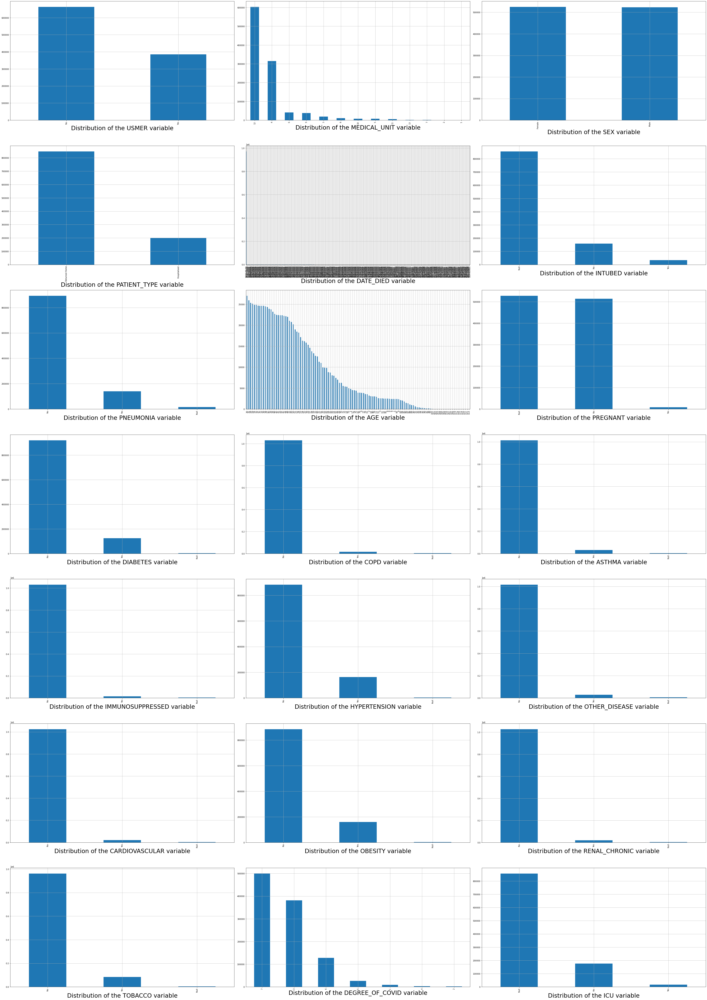

In [8]:
#Visualise the distribution for each feature
plt.figure(figsize=[50, 80])

for i, column in enumerate(covid_data.columns):
    plt.subplot(8, 3, i + 1)
    # Include null values in the counts
    data = covid_data[column].fillna('Null').value_counts()
    data.plot(kind='bar')
    plt.xlabel(f'Distribution of the {column} variable', fontsize=30)
    plt.grid()

plt.tight_layout()
plt.show()

In [9]:
#list all the columns that have null values
covid_data.columns[covid_data.isnull().any()].tolist()


['INTUBED',
 'PNEUMONIA',
 'PREGNANT',
 'DIABETES',
 'COPD',
 'ASTHMA',
 'IMMUNOSUPPRESSED',
 'HYPERTENSION',
 'OTHER_DISEASE',
 'CARDIOVASCULAR',
 'OBESITY',
 'RENAL_CHRONIC',
 'TOBACCO',
 'ICU']

#### 1.1.1 INTUBED VARIABLE

According to the data dictionary, these are patients connected to the ventilator. Using the `PATIENT_TYPE` column, we can assume that patients sent home cannot be on the ventilator at home


In [10]:
# Count the number of Null INTUBED values
covid_data["INTUBED"].isna().sum()

855869

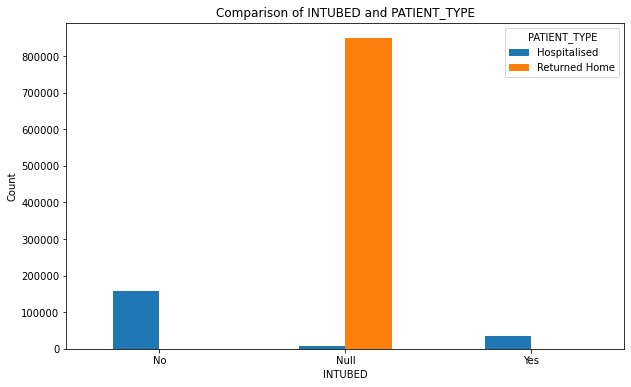

In [11]:
# Temporarily fill null values in INTUBED for visualization
temp_intubed = covid_data['INTUBED'].fillna('Null')

# Create a cross-tabulation of the two columns
cross_tab = pd.crosstab(temp_intubed, covid_data['PATIENT_TYPE'])

# Plotting
cross_tab.plot(kind='bar', figsize=(10, 6))

plt.title('Comparison of INTUBED and PATIENT_TYPE')
plt.xlabel('INTUBED')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='PATIENT_TYPE')

plt.show()


In [12]:
# Show the distribution of INTUBED vs PATIENT_TYPE
print(f"Number of cells with INTUBED null and PATIENT_TYPE as 'Returned Home': {covid_data[(covid_data['INTUBED'].isnull()) & (covid_data['PATIENT_TYPE'] == 'Returned Home')].shape[0]}")
print(f"Number of cells with INTUBED null and PATIENT_TYPE as 'Hospitalised': {covid_data[(covid_data['INTUBED'].isnull()) & (covid_data['PATIENT_TYPE'] == 'Hospitalised')].shape[0]}")




Number of cells with INTUBED null and PATIENT_TYPE as 'Returned Home': 848544
Number of cells with INTUBED null and PATIENT_TYPE as 'Hospitalised': 7325


In [13]:
# Patients at home cannot be on a ventilator
#Change NaN in INTUBED to 'No' where PATIENT_TYPE is 'Returned Home'
covid_data.loc[covid_data['PATIENT_TYPE'] == 'Returned Home', 'INTUBED'] = covid_data.loc[covid_data['PATIENT_TYPE'] == 'Returned Home', 'INTUBED'].fillna('No')

print(f"Number of cells with INTUBED null and PATIENT_TYPE as 'Returned Home': {covid_data[(covid_data['INTUBED'].isnull()) & (covid_data['PATIENT_TYPE'] == 'Returned Home')].shape[0]}")
print(f"Number of cells with INTUBED null and PATIENT_TYPE as 'Hospitalised': {covid_data[(covid_data['INTUBED'].isnull()) & (covid_data['PATIENT_TYPE'] == 'Hospitalised')].shape[0]}")
print(f"Remaining INTUBED null values are: {covid_data.INTUBED.isna().sum()}")

Number of cells with INTUBED null and PATIENT_TYPE as 'Returned Home': 0
Number of cells with INTUBED null and PATIENT_TYPE as 'Hospitalised': 7325
Remaining INTUBED null values are: 7325


So we have 7325 patients still Hospitalised that we do not know if they are on ventilator or not

#### 1.1.2 PREGNANT VARIABLE


In [14]:
# What values are included in the PREGNANT variable
covid_data["PREGNANT"].unique()

array(['No', nan, 'Yes'], dtype=object)

In [15]:
#How many null values are there in the PREGNANT column
covid_data["PREGNANT"].isna().sum()

527265

In [16]:
#The `PREGNANT` variable can be compare to the `SEX` column which only has 2 values: Male and Female
covid_data["SEX"].unique()

array(['Female', 'Male'], dtype=object)

In [17]:
# Count the number of Males, females
print(f" Males: {covid_data['SEX'].value_counts().get('Male', 0)}")
print(f" Females: {covid_data['SEX'].value_counts().get('Male', 0)}")

 Males: 523511
 Females: 523511


The number of Males and the number of females are equal

Since Males cannot be pregnant, we will look at the relationship between the `SEX` column and the `PREGNANT` column

In [18]:
print(f"Pregnant women: {covid_data[(covid_data['PREGNANT'] == 'Yes') & (covid_data['SEX'] == 'Female')].shape[0]}")
print(f"Pregnant Men: {covid_data[(covid_data['PREGNANT'] == 'Yes') & (covid_data['SEX'] == 'Male')].shape[0]}")
print(f"Non-pregnant Women: {covid_data[(covid_data['PREGNANT'] == 'No') & (covid_data['SEX'] == 'Female')].shape[0]}")
print(f"Non-pregnant Men: {covid_data[(covid_data['PREGNANT'] == 'No') & (covid_data['SEX'] == 'Male')].shape[0]}")
print(f"Null values women for pregnancy: {covid_data[(covid_data['PREGNANT'].isnull()) & (covid_data['SEX'] == 'Female')].shape[0]}")
print(f"Null values Men Pregnancy: {covid_data[(covid_data['PREGNANT'].isnull()) & (covid_data['SEX'] == 'Male')].shape[0]}")


Pregnant women: 8131
Pregnant Men: 0
Non-pregnant Women: 513179
Non-pregnant Men: 0
Null values women for pregnancy: 3754
Null values Men Pregnancy: 523511


Clearly these show that the null values for men actually should be no since they cannot be pregnant, while the null values for women are the true missing values

In [19]:
#Change NaN in `PREGNANT` to 'No' where `SEX` is 'MALE'
covid_data.loc[covid_data["SEX"] == "Male", "PREGNANT"] = covid_data.loc[covid_data["SEX"] == "Male", 'PREGNANT'].fillna("No")
print(f"Pregnant Men: {covid_data[(covid_data['PREGNANT'] == 'Yes') & (covid_data['SEX'] == 'Male')].shape[0]}")
print(f"Non-pregnant Men: {covid_data[(covid_data['PREGNANT'] == 'No') & (covid_data['SEX'] == 'Male')].shape[0]}")
print(f"Null values Men Pregnancy: {covid_data[(covid_data['PREGNANT'].isnull()) & (covid_data['SEX'] == 'Male')].shape[0]}")


Pregnant Men: 0
Non-pregnant Men: 523511
Null values Men Pregnancy: 0


In [20]:
print(f"The actual missing values for pregnancy are: {covid_data[(covid_data['PREGNANT'].isnull()) & (covid_data['SEX'] == 'Female')].shape[0]}")


The actual missing values for pregnancy are: 3754


#### 1.1.3 ICU VARIABLE

In [21]:
# Count the number of null ICU values
covid_data["ICU"].isna().sum()

856032

To be in the intensive care unit, the patient should still be hospitalised.
To use a ventilator, the patient needs to be in the ICU.

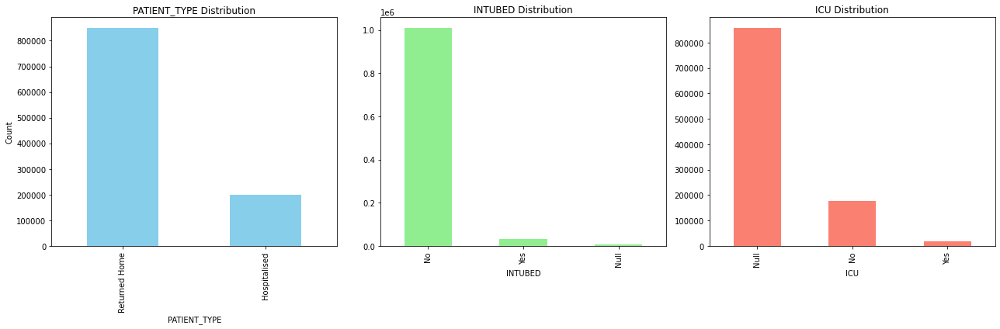

In [22]:
# Visualise the data between the ICU, INTUBED and PATIENT_TYPE columns
# Creating a figure with 3 subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Plotting PATIENT_TYPE
covid_data['PATIENT_TYPE'].value_counts().plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('PATIENT_TYPE Distribution')
axes[0].set_ylabel('Count')
axes[0].set_xlabel('PATIENT_TYPE')

# Plotting INTUBED
covid_data['INTUBED'].fillna('Null').value_counts().plot(kind='bar', ax=axes[1], color='lightgreen')
axes[1].set_title('INTUBED Distribution')
axes[1].set_xlabel('INTUBED')

# Plotting ICU
covid_data['ICU'].fillna('Null').value_counts().plot(kind='bar', ax=axes[2], color='salmon')
axes[2].set_title('ICU Distribution')
axes[2].set_xlabel('ICU')

# Adjusting layout
plt.tight_layout()
plt.show()


There is a pattern showing that a good deal of Null values in ICU should be No because the patients have returned home. 

In [23]:
# Count rows have ICU as null and PATIENT_TYPE as 'Returned Home'
(covid_data['ICU'].isnull() & (covid_data['PATIENT_TYPE'] == 'Returned Home')).sum()

848544

In [24]:
# Show rows have ICU as null and PATIENT_TYPE as 'Returned Home'
covid_data[(covid_data['ICU'].isnull()) & (covid_data['PATIENT_TYPE'] == 'Returned Home')]

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DATE_DIED,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU
0,No,1,Female,Returned Home,03/05/2020,No,Yes,65,No,No,No,No,No,Yes,No,No,No,No,No,3,NaN
1,No,1,Male,Returned Home,03/06/2020,No,Yes,72,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,NaN
3,No,1,Female,Returned Home,12/06/2020,No,No,53,No,No,No,No,No,No,No,No,No,No,No,7,NaN
4,No,1,Male,Returned Home,21/06/2020,No,No,68,No,Yes,No,No,No,Yes,No,No,No,No,No,3,NaN
6,No,1,Female,Returned Home,9999-99-99,No,No,64,No,No,No,No,No,No,No,No,No,No,No,3,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048568,Yes,13,Male,Returned Home,9999-99-99,No,No,47,No,Yes,No,No,No,No,No,No,No,No,No,7,NaN
1048570,No,13,Male,Returned Home,9999-99-99,No,No,40,No,No,No,No,No,No,No,No,No,No,No,7,NaN
1048572,No,13,Male,Returned Home,9999-99-99,No,No,55,No,No,No,No,No,No,No,No,No,No,No,7,NaN
1048573,No,13,Male,Returned Home,9999-99-99,No,No,28,No,No,No,No,No,No,No,No,No,No,No,7,NaN


None of these people that have returned hom can possible in the ICU

In [25]:
# Change all ICU null values to No where PATIENT_TYPE is 'Returned home'
covid_data.loc[covid_data['PATIENT_TYPE'] == 'Returned Home', 'ICU'] = covid_data.loc[covid_data['PATIENT_TYPE'] == 'Returned Home', 'ICU'].apply(lambda x: 'No' if pd.isnull(x) else x)
(covid_data['ICU'].isnull() & (covid_data['PATIENT_TYPE'] == 'Returned Home')).sum()

0

All patients on ventilator will be in the intensive care unit

In [26]:
# Check if there are patients showing null for ICU and are on ventilator
(covid_data['ICU'].isnull() & (covid_data['INTUBED'] == 'Yes')).sum()

54

In [27]:
# Change all ICU null values to 'Yes' where 'INTUBED' is 'Yes'
covid_data.loc[covid_data['INTUBED'] == 'Yes', 'ICU'] = covid_data.loc[covid_data['INTUBED'] == 'Yes', 'ICU'].apply(lambda x: 'Yes' if pd.isnull(x) else x)
(covid_data['ICU'].isnull() & (covid_data['INTUBED'] == 'Yes')).sum()

0

In [28]:
# Count the number of the true missing ICU values
covid_data["ICU"].isna().sum()

7434

At this point, we can no longer impute for any more missing values

In [29]:
# Check the size of the data
covid_data.size, covid_data.isnull().sum().sum()

(22020075, 67723)

In [30]:
# Calculate what percentage of the data is null
(covid_data.isnull().sum().sum() / covid_data.size) * 100

0.3075511777321376

In [31]:
# Calculate what percentage of the rowcount has null values
(covid_data.isnull().any(axis=1).sum() / len(covid_data)) * 100

2.7520205993848794

In [32]:
# Iterating through each column and printing the percentage of null values only for columns with nulls
for column in covid_data.columns:
    null_count = covid_data[column].isnull().sum()
    if null_count > 0:  # Check if the column has any null values
        null_percentage = (null_count / len(covid_data)) * 100
        print(f"{column} has {null_percentage:.2f}% null ")


INTUBED has 0.70% null 
PNEUMONIA has 1.53% null 
PREGNANT has 0.36% null 
DIABETES has 0.32% null 
COPD has 0.29% null 
ASTHMA has 0.28% null 
IMMUNOSUPPRESSED has 0.32% null 
HYPERTENSION has 0.30% null 
OTHER_DISEASE has 0.48% null 
CARDIOVASCULAR has 0.29% null 
OBESITY has 0.29% null 
RENAL_CHRONIC has 0.29% null 
TOBACCO has 0.31% null 
ICU has 0.71% null 


only 0.31% of the total data is null

only 2.75% of the total number of rows have null values

less than 2% of any column is null

so it is safe to drop the null values and have clean data for the modelling

In [33]:
covid_data.dropna(inplace=True)
covid_data.isna().sum()

USMER               0
MEDICAL_UNIT        0
SEX                 0
PATIENT_TYPE        0
DATE_DIED           0
INTUBED             0
PNEUMONIA           0
AGE                 0
PREGNANT            0
DIABETES            0
COPD                0
ASTHMA              0
IMMUNOSUPPRESSED    0
HYPERTENSION        0
OTHER_DISEASE       0
CARDIOVASCULAR      0
OBESITY             0
RENAL_CHRONIC       0
TOBACCO             0
DEGREE_OF_COVID     0
ICU                 0
dtype: int64

### 1.2 HANDLING THE REMAINING VARIABLES
Now that we have finished imputation for missing values, we can look at the others variable for the modelling


#### 1.2.1 TARGET VARIABLE

Since the aim is to determine the risk of death due to covid using clinical parameters, the only column indicating any death is the **`DATE_DIED`** column. This column holds the values for our target variable

In [34]:
covid_data["DATE_DIED"].value_counts()

9999-99-99    946400
06/07/2020       966
07/07/2020       963
13/07/2020       947
16/06/2020       937
               ...  
10/09/2020         1
19/04/2021         1
30/10/2020         1
24/03/2021         1
22/04/2021         1
Name: DATE_DIED, Length: 393, dtype: int64

The data dictionary indicates that 9999-99-99 means that there is no date i.e. the patient is still alive..

We are not interested in the dates that people died, but only in the fact that they died. Therefore, this column will be mapped to show yes or no for DATE_DIED, and this column will be renamed to DEAD

In [35]:
covid_data.rename(columns={"DATE_DIED":"DEAD"}, inplace=True)

In [36]:
covid_data["DEAD"] = covid_data["DEAD"].apply(lambda x: "No" if x == "9999-99-99" else "Yes")

In [37]:
covid_data.head()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU
0,No,1,Female,Returned Home,Yes,No,Yes,65,No,No,No,No,No,Yes,No,No,No,No,No,3,No
1,No,1,Male,Returned Home,Yes,No,Yes,72,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,No
2,No,1,Male,Hospitalised,Yes,Yes,No,55,No,Yes,No,No,No,No,No,No,No,No,No,3,No
3,No,1,Female,Returned Home,Yes,No,No,53,No,No,No,No,No,No,No,No,No,No,No,7,No
4,No,1,Male,Returned Home,Yes,No,No,68,No,Yes,No,No,No,Yes,No,No,No,No,No,3,No


`DEAD` is the target to be determined by the ML models. View the distibution of the number of dead people

In [38]:
# View the distibution of the number of dead people
dead_value_counts = covid_data["DEAD"].value_counts()
fig = px.bar(dead_value_counts, orientation="h",
            x=dead_value_counts.values,
            y=dead_value_counts.index,
            labels={"x": "Death distribution", "y":"Dead or Not"},
            title="Number of the living vs the dead")
fig.show()

There is a clear imbalance in our data, but this imbalance would be addressed durig the actual modelling phase.

#### 1.2.2 AGE
The `AGE`variable gives us the age of the patients on the dataset.

In [39]:
# Extracting the age data
age_data = covid_data['AGE']

# Creating the histogram
fig = go.Figure(data=[go.Histogram(x=age_data, marker_color='red')])

# Updating layout for the plot
fig.update_layout(
    title='Distribution of Age',
    xaxis_title='Age',
    yaxis_title='Count',
    bargap=0.2,  # Gap between bars of adjacent location coordinates
    template='plotly_dark'  # or choose 'plotly', 'plotly_white', etc.
)

# Showing the plot
fig.show()


Out of a million samples, the data sometimes presents only one person for a certain age, making it less accurate to predict covid outcomes for a single age, so we will group the age coulums by decade for better modelling.

In [40]:
# Make a copy of the dataframe
covid_data2 = covid_data.copy()

# Create a function to make the age categorization easier
def map_age_to_group(age):
    if age < 10:
        return 'AGE_0-9'
    elif age < 20:
        return 'AGE_10-19'
    elif age < 30:
        return 'AGE_20-29'
    elif age < 40:
        return 'AGE_30-39'
    elif age < 50:
        return 'AGE_40-49'
    elif age < 60:
        return 'AGE_50-59'
    elif age < 70:
        return 'AGE_60-69'
    elif age < 80:
        return 'AGE_70-79'
    elif age < 90:
        return 'AGE_80-89'
    else:
        return 'AGE_OVER_90'

# Apply the function to the AGE column
covid_data2['AGE'] = covid_data2['AGE'].apply(map_age_to_group)
covid_data2

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU
0,No,1,Female,Returned Home,Yes,No,Yes,AGE_60-69,No,No,No,No,No,Yes,No,No,No,No,No,3,No
1,No,1,Male,Returned Home,Yes,No,Yes,AGE_70-79,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,No
2,No,1,Male,Hospitalised,Yes,Yes,No,AGE_50-59,No,Yes,No,No,No,No,No,No,No,No,No,3,No
3,No,1,Female,Returned Home,Yes,No,No,AGE_50-59,No,No,No,No,No,No,No,No,No,No,No,7,No
4,No,1,Male,Returned Home,Yes,No,No,AGE_60-69,No,Yes,No,No,No,Yes,No,No,No,No,No,3,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,No,13,Male,Returned Home,No,No,No,AGE_40-49,No,No,No,No,No,No,No,No,No,No,No,7,No
1048571,Yes,13,Male,Hospitalised,No,No,No,AGE_50-59,No,No,No,No,No,Yes,No,No,No,No,No,7,No
1048572,No,13,Male,Returned Home,No,No,No,AGE_50-59,No,No,No,No,No,No,No,No,No,No,No,7,No
1048573,No,13,Male,Returned Home,No,No,No,AGE_20-29,No,No,No,No,No,No,No,No,No,No,No,7,No


In [41]:
covid_data2.AGE.value_counts()

AGE_30-39      244485
AGE_40-49      218645
AGE_20-29      182255
AGE_50-59      160748
AGE_60-69       86868
AGE_70-79       43587
AGE_10-19       36687
AGE_0-9         25301
AGE_80-89       17767
AGE_OVER_90      3375
Name: AGE, dtype: int64

In [42]:
#Concatenate these values to the dataframe for modelling
concat_df = pd.get_dummies(covid_data2['AGE'])
covid_data2 = pd.concat([covid_data2, concat_df], axis = 1)
covid_data2.head()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,AGE,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90
0,No,1,Female,Returned Home,Yes,No,Yes,AGE_60-69,No,No,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0
1,No,1,Male,Returned Home,Yes,No,Yes,AGE_70-79,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,No,0,0,0,0,0,0,0,1,0,0
2,No,1,Male,Hospitalised,Yes,Yes,No,AGE_50-59,No,Yes,No,No,No,No,No,No,No,No,No,3,No,0,0,0,0,0,1,0,0,0,0
3,No,1,Female,Returned Home,Yes,No,No,AGE_50-59,No,No,No,No,No,No,No,No,No,No,No,7,No,0,0,0,0,0,1,0,0,0,0
4,No,1,Male,Returned Home,Yes,No,No,AGE_60-69,No,Yes,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0


We no longer need the original `AGE` column since the Ages have been split by the decades

In [43]:
covid_data2.drop('AGE', axis = 1, inplace = True)
covid_data2.head()

,USMER,MEDICAL_UNIT,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90
0,No,1,Female,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0
1,No,1,Male,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,No,0,0,0,0,0,0,0,1,0,0
2,No,1,Male,Hospitalised,Yes,Yes,No,No,Yes,No,No,No,No,No,No,No,No,No,3,No,0,0,0,0,0,1,0,0,0,0
3,No,1,Female,Returned Home,Yes,No,No,No,No,No,No,No,No,No,No,No,No,No,7,No,0,0,0,0,0,1,0,0,0,0
4,No,1,Male,Returned Home,Yes,No,No,No,Yes,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0


#### 1.2.3 MEDICAL UNIT
The medical unit variable is ordinal and does not give us any further information other than the number of the unit in which tha patient was admitted. This information doesn't have an impact on the case trajectories of COVID-19 patients based on clinical parameters. Drop `MEDICAL_UNIT`

In [44]:
covid_data2.drop('MEDICAL_UNIT', axis = 1, inplace = True)
covid_data2.head()

,USMER,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90
0,No,Female,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0
1,No,Male,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,Yes,Yes,No,5,No,0,0,0,0,0,0,0,1,0,0
2,No,Male,Hospitalised,Yes,Yes,No,No,Yes,No,No,No,No,No,No,No,No,No,3,No,0,0,0,0,0,1,0,0,0,0
3,No,Female,Returned Home,Yes,No,No,No,No,No,No,No,No,No,No,No,No,No,7,No,0,0,0,0,0,1,0,0,0,0
4,No,Male,Returned Home,Yes,No,No,No,Yes,No,No,No,Yes,No,No,No,No,No,3,No,0,0,0,0,0,0,1,0,0,0


#### 1.2.4 DEGREE_OF_COVID
The data dictionary defines `DEGREE_OF_COVID` as Covid test findings. 1-3 means that the patient was diagnosed with covid in different degrees. 4 or higher means that the patient is not a carrier of covid or that the test was inconclusive.

In [45]:
covid_data2["DEGREE_OF_COVID"].value_counts()

7    488161
3    375928
6    117182
5     25185
1      8397
4      3082
2      1783
Name: DEGREE_OF_COVID, dtype: int64

Numbers 4, 5, 6, and 7 have the same categorization (4 or higher means that the patient is not a carrier of covid or that the test was inconclusive.). The data dictionary does not explain which category was negative for covid, nor does it state which ones are inconclusive. Split this into just to categories: 1 for yes and 0 for no.

In [46]:
covid_data2["DEGREE_OF_COVID"].replace({1:1, 2:1, 3:1, 4:0, 5:0, 6:0, 7:0}, inplace = True)
covid_data2.head()

,USMER,SEX,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90
0,No,Female,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,No,No,No,1,No,0,0,0,0,0,0,1,0,0,0
1,No,Male,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,Yes,Yes,No,0,No,0,0,0,0,0,0,0,1,0,0
2,No,Male,Hospitalised,Yes,Yes,No,No,Yes,No,No,No,No,No,No,No,No,No,1,No,0,0,0,0,0,1,0,0,0,0
3,No,Female,Returned Home,Yes,No,No,No,No,No,No,No,No,No,No,No,No,No,0,No,0,0,0,0,0,1,0,0,0,0
4,No,Male,Returned Home,Yes,No,No,No,Yes,No,No,No,Yes,No,No,No,No,No,1,No,0,0,0,0,0,0,1,0,0,0


#### 1.2.5 SEX VARIABLE
The `SEX` variable is either male or female. We can split this into two columns, one for Male, and one for female, using `0` for no and `1` for yes.

In [47]:
sex_encode_dummy = pd.get_dummies(covid_data2["SEX"])
covid_data2 = pd.concat([covid_data2, sex_encode_dummy], axis = 1)
covid_data2.drop("SEX", axis = 1, inplace = True)
covid_data2.head(10)

,USMER,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
0,No,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,No,No,No,1,No,0,0,0,0,0,0,1,0,0,0,1,0
1,No,Returned Home,Yes,No,Yes,No,No,No,No,No,Yes,No,No,Yes,Yes,No,0,No,0,0,0,0,0,0,0,1,0,0,0,1
2,No,Hospitalised,Yes,Yes,No,No,Yes,No,No,No,No,No,No,No,No,No,1,No,0,0,0,0,0,1,0,0,0,0,0,1
3,No,Returned Home,Yes,No,No,No,No,No,No,No,No,No,No,No,No,No,0,No,0,0,0,0,0,1,0,0,0,0,1,0
4,No,Returned Home,Yes,No,No,No,Yes,No,No,No,Yes,No,No,No,No,No,1,No,0,0,0,0,0,0,1,0,0,0,0,1
5,No,Hospitalised,No,No,Yes,No,No,No,No,No,No,No,No,No,No,No,1,No,0,0,0,0,1,0,0,0,0,0,1,0
6,No,Returned Home,No,No,No,No,No,No,No,No,No,No,No,No,No,No,1,No,0,0,0,0,0,0,1,0,0,0,1,0
7,No,Returned Home,No,No,Yes,No,Yes,No,No,Yes,Yes,No,No,No,Yes,No,1,No,0,0,0,0,0,0,1,0,0,0,1,0
8,No,Hospitalised,No,No,No,No,Yes,No,No,No,Yes,No,No,Yes,No,No,1,No,0,0,0,1,0,0,0,0,0,0,1,0
9,No,Hospitalised,No,No,No,No,No,No,No,No,No,No,No,No,No,No,1,No,0,0,1,0,0,0,0,0,0,0,1,0


1.2.6 BOOLEAN VALUES
All the values remaining in the table are Boolean. Since Machine learning requires numeric data, convert all the `Yes` to `1` and all the `No` to `0`

In [48]:
covid_data3 = covid_data2.copy()
# Define the mapping dictionary
replacement_dict = {
    'Yes': 1,
    'No': 0,
    'Returned Home': 1,
    'Hospitalised': 0
}

# Apply the replacement to the entire DataFrame
covid_data3.replace(replacement_dict, inplace=True)
covid_data3.head()

,USMER,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,1,1,0,1,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1
3,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1


In [49]:
covid_data3.dtypes

USMER               int64
PATIENT_TYPE        int64
DEAD                int64
INTUBED             int64
PNEUMONIA           int64
PREGNANT            int64
DIABETES            int64
COPD                int64
ASTHMA              int64
IMMUNOSUPPRESSED    int64
HYPERTENSION        int64
OTHER_DISEASE       int64
CARDIOVASCULAR      int64
OBESITY             int64
RENAL_CHRONIC       int64
TOBACCO             int64
DEGREE_OF_COVID     int64
ICU                 int64
AGE_0-9             uint8
AGE_10-19           uint8
AGE_20-29           uint8
AGE_30-39           uint8
AGE_40-49           uint8
AGE_50-59           uint8
AGE_60-69           uint8
AGE_70-79           uint8
AGE_80-89           uint8
AGE_OVER_90         uint8
Female              uint8
Male                uint8
dtype: object

In [50]:
covid_data3.head(10)

,USMER,PATIENT_TYPE,DEAD,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
0,0,1,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,1,1,0,1,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1
3,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,0,1,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1
5,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0
6,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
7,0,1,0,0,1,0,1,0,0,1,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
8,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0


The data is cleaned and ready for Modelling

## 2. Data Modelling


### 2.1 Base Model Creation

Since our target variable is `DEAD`, it would be pertinent to look at the distribution of dead people in the dataset

In [51]:
# View the distibution of the number of dead people
dead_value_counts = covid_data3["DEAD"].value_counts()
fig = px.bar(dead_value_counts, orientation="h",
            x=dead_value_counts.values,
            y=dead_value_counts.index,
            labels={"x": "Death distribution", "y":"Dead or Not"},
            title="Number of the living vs the dead")
fig.show()

The number of living far outweighs the number of the dead, leading to an imbalance which must be taken into consideration after splitting but before training.
`train_test_split(stratify=y)` ensures that the proportion of classes in the target variable y is the same (or as close as possible) in both the training and testing sets as it is in the original dataset. This is particularly important in imbalanced datasets like this one where one class significantly outnumbers the other, as it helps in maintaining the original class distribution.

The dependent variable (target) is `DEAD`, because that is the column that tells us if the patient is dead or not. The other columns are independent variables. We will now split the data into `X` and `y` (features and labels).

In [52]:
# Split data into X and y
X = covid_data3.drop("DEAD", axis=1)
y=covid_data3["DEAD"]

In [53]:
X

,USMER,PATIENT_TYPE,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,1,0,1,0,0,0,0,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1
2,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1
3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
4,0,1,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
1048571,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1048572,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1
1048573,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1


In [54]:
y

0          1
1          1
2          1
3          1
4          1
          ..
1048570    0
1048571    0
1048572    0
1048573    0
1048574    0
Name: DEAD, Length: 1019718, dtype: int64

In [55]:
# Split data into train and test sets noting the imbalance
"""

"""
np.random.seed(42) # to make reproducible results

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y)


View the splits

In [56]:
X_train.shape, y_train.shape


((815774, 29), (815774,))

In [57]:
X_test.shape, y_test.shape

((203944, 29), (203944,))

In [58]:
X_train

,USMER,PATIENT_TYPE,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
436238,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0
1017573,1,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1
41150,1,0,0,1,0,1,1,0,0,1,1,1,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1
549858,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,0,0,1,0
45955,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
720607,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0
972148,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
1013362,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
200065,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1


In [59]:
y_train

436238     0
1017573    0
41150      1
549858     0
45955      1
          ..
720607     0
972148     0
1013362    0
200065     0
555654     0
Name: DEAD, Length: 815774, dtype: int64

In [60]:
X_test

,USMER,PATIENT_TYPE,INTUBED,PNEUMONIA,PREGNANT,DIABETES,COPD,ASTHMA,IMMUNOSUPPRESSED,HYPERTENSION,OTHER_DISEASE,CARDIOVASCULAR,OBESITY,RENAL_CHRONIC,TOBACCO,DEGREE_OF_COVID,ICU,AGE_0-9,AGE_10-19,AGE_20-29,AGE_30-39,AGE_40-49,AGE_50-59,AGE_60-69,AGE_70-79,AGE_80-89,AGE_OVER_90,Female,Male
65537,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0
705564,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1
951811,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0
56555,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,1,0
630427,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
870715,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0
9494,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0
624064,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,1
1005651,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0


In [61]:
y_test

65537      0
705564     0
951811     0
56555      1
630427     0
          ..
870715     0
9494       0
624064     0
1005651    0
898760     0
Name: DEAD, Length: 203944, dtype: int64

The data has been spilt into training and test data, it is time to build, train and test the machine learning models.
The models to be used for this exercise are:

    1. Logistic Regression
    2. Extreme Gradient Boosting Classifier
    3. Random Forest Classifier


In [62]:
# XGBoost uses scale_pos_weight to address imbalance
#create a variable to balance the negative and positive weights for XGBoost
# DEAD=0 is the majority, and DEAD=1 is the minority count

majority_count = sum(y_train == 0)
minority_count = sum(y_train == 1)

scp = majority_count / minority_count


In [63]:
# Define classifiers with class_weight parameter for imbalance and n_jobs for parallel processing
clfs = {
    "Logistic Regression": Pipeline(steps=[('poly', PolynomialFeatures(degree=2)),
                                           ('scaler', MinMaxScaler()),
                                           ('classifier', LogisticRegression(class_weight='balanced'))]),
    "XGBoost": Pipeline(steps=[('poly', PolynomialFeatures(degree=2)),
                               ('scaler', MinMaxScaler()),
                               ('classifier', xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss', scale_pos_weight=scp))]),  # XGBoost with default settings
    "Random Forest": Pipeline(steps=[('poly', PolynomialFeatures(degree=2)),
                                     ('scaler', MinMaxScaler()),
                                     ('classifier', RandomForestClassifier(class_weight='balanced', n_jobs=-1))])  # Use all processors
}

# Define a function for fitting and scoring the classifiers
def fit_score(clfs, X_train, X_test, y_train, y_test):
    """
    clf: dictionary of the different Scikit-learn classifiers
    X_train: label-free training data
    y_train: training labels
    X_test: label-free test data
    y_test: test labels
    """
    np.random.seed(42)
    clf_scores = {}
    for name, clf in clfs.items():
        clf.fit(X_train, y_train)
        clf_scores[name] = clf.score(X_test, y_test)
    return clf_scores


In [64]:
clf_scores = fit_score(clfs=clfs,
                      X_train=X_train,
                      X_test=X_test,
                      y_train=y_train,
                      y_test=y_test)
clf_scores

C:\Users\lacho\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



{'Logistic Regression': 0.8882781547875888,
 'XGBoost': 0.8890921037147452,
 'Random Forest': 0.8985015494449456}

### 2.2 Hyperparameter Tuning using RandomizedSearchCV

To Optimise the results of our Machine Learning models, the hyperparameters of all the models would be used to improve the peformance of these modles. Becaouse of the limited Computational powers of the computer employed for the modelling, RandomisedSearchCV is employed for this purpose

#### 2.2.1 Create the Grids

In [67]:
#Logistic Regression hyperparameter grid
log_reg_grid = {"C": np.logspace(-4, 4, 20),
               "solver": ["liblinear"]}

# XGBoost Grid
xgb_grid = {"n_estimators": np.arange(10, 1000, 50)}

# RandomForest Grid
rf_grid = {"n_estimators": np.arange(10, 1000, 50),
          "max_depth": [None, 3, 5, 10],
          "min_samples_split":  np.arange(2, 20, 2),
          "min_samples_leaf": np.arange(1, 20, 2)}

#### 2.2.2 Tune these grids using RandomisedSearchCV

Note:

* The cross-validation is limited to 5 combinations due to computational power

In [68]:
# Tune LogisticRegression
#udemy 
np.random.seed(42)

# Logisticregression Hyperparameter search setup
rs_log_reg = RandomizedSearchCV(LogisticRegression(),
                               param_distributions=log_reg_grid,
                               cv=5,
                               n_iter=20,
                               verbose=True)

# Random Hyperparameter Fitting for Logistic Regression
rs_log_reg.fit(X_train, y_train)


Fitting 5 folds for each of 20 candidates, totalling 100 fits


RandomizedSearchCV(cv=5, estimator=LogisticRegression(), n_iter=20,
                   param_distributions={'C': array([1.00000000e-04, 2.63665090e-04, 6.95192796e-04, 1.83298071e-03,
       4.83293024e-03, 1.27427499e-02, 3.35981829e-02, 8.85866790e-02,
       2.33572147e-01, 6.15848211e-01, 1.62377674e+00, 4.28133240e+00,
       1.12883789e+01, 2.97635144e+01, 7.84759970e+01, 2.06913808e+02,
       5.45559478e+02, 1.43844989e+03, 3.79269019e+03, 1.00000000e+04]),
                                        'solver': ['liblinear']},
                   verbose=True)

In [69]:
rs_log_reg.best_params_

{'solver': 'liblinear', 'C': 0.012742749857031334}

In [70]:
rs_log_reg.score(X_test, y_test)

0.94911348213235

In [72]:
from scipy.stats import uniform, randint

# Enhanced Logistic Regression hyperparameter grid with class_weight for imbalance
log_reg_grid = {
    "C": np.logspace(-4, 4, 20),
    "solver": ["liblinear"],
    "penalty": ["l1", "l2"],
    "class_weight": ['balanced']  # Addressing class imbalance
}

# Expanded XGBoost Grid with scale_pos_weight for imbalance
xgb_grid = {
    "n_estimators": np.arange(100, 1000, 100),
    "learning_rate": uniform(0.01, 0.3),
    "max_depth": randint(3, 10),
    "min_child_weight": randint(1, 10),
    "subsample": uniform(0.6, 0.4),
    "colsample_bytree": uniform(0.6, 0.4),
    "gamma": uniform(0, 0.5),
    "scale_pos_weight": [10]  # Adjusted for 10:1 class imbalance
}

# RandomForest Grid with class_weight for imbalance
rf_grid = {
    "n_estimators": np.arange(10, 1000, 50),
    "max_depth": [None, 3, 5, 10],
    "min_samples_split": np.arange(2, 20, 2),
    "min_samples_leaf": np.arange(1, 20, 2),
    "max_features": ['auto', 'sqrt', 'log2'],
    "class_weight": ['balanced', 'balanced_subsample']  # Addressing class imbalance
}

# Setup for RandomizedSearchCV for each model

# Logistic Regression
rs_log_reg = RandomizedSearchCV(LogisticRegression(),
                                param_distributions=log_reg_grid,
                                cv=5,
                                n_iter=20,
                                verbose=True,
                                scoring='roc_auc')

# XGBoost
rs_xgb = RandomizedSearchCV(xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss'),
                            param_distributions=xgb_grid,
                            cv=5,
                            n_iter=20,
                            verbose=True,
                            scoring='roc_auc')

# Random Forest
rs_rf = RandomizedSearchCV(RandomForestClassifier(),
                           param_distributions=rf_grid,
                           cv=5,
                           n_iter=20,
                           verbose=True,
                           scoring='roc_auc')

In [74]:
# Logistic regression 
print("Tuning Logistic Regression...")
rs_log_reg.fit(X_train, y_train)

# Best parameters and scores
print(f"Logistic Regression Best Params: {rs_log_reg.best_params_} and Best Score: {rs_log_reg.best_score_}")


Tuning Logistic Regression...
Fitting 5 folds for each of 20 candidates, totalling 100 fits
Logistic Regression Best Params: {'solver': 'liblinear', 'penalty': 'l1', 'class_weight': 'balanced', 'C': 545.5594781168514} and Best Score: 0.9604760671059797


In [78]:
rs_log_reg.score(X_test, y_test)

0.9612333760022762

In [ ]:
# XGBoost
print("Tuning XGBoost...")
rs_xgb.fit(X_train, y_train)

# Best parameters and scores
print(f"XGBoost Best Params: {rs_xgb.best_params_} and Best Score: {rs_xgb.best_score_}")


In [ ]:
rs_xgb.score(X_test, y_test)

In [ ]:
rs_rf.score(X_test, y_test)

In [ ]:
#RandomForest
print("Tuning Random Forest...")
rs_rf.fit(X_train, y_train)

# Best parameters and scores
print(f"Random Forest Best Params: {rs_rf.best_params_} and Best Score: {rs_rf.best_score_}")
